In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
import nltk
#import PorterStemmer for the stemming purpose
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import sent_tokenize, word_tokenize

In [2]:
train_df=pd.read_csv("/content/drive/MyDrive/Datasets/Train.csv")
train_df.head()

,text,label
0,I grew up (b. 1965) watching and loving the Th...,0
1,"When I put this movie in my DVD player, and sa...",0
2,Why do people who do not know what a particula...,0
3,Even though I have great interest in Biblical ...,0
4,Im a die hard Dads Army fan and nothing will e...,1


In [3]:
test_df=pd.read_csv("/content/drive/MyDrive/Datasets/Test.csv")
test_df.head()

,text,label
0,I always wrote this series off as being a comp...,0
1,1st watched 12/7/2002 - 3 out of 10(Dir-Steve ...,0
2,This movie was so poorly written and directed ...,0
3,The most interesting thing about Miryang (Secr...,1
4,"when i first read about ""berlin am meer"" i did...",0


In [4]:
train_df["dist"]="train"
train_df.head()

,text,label,dist
0,I grew up (b. 1965) watching and loving the Th...,0,train
1,"When I put this movie in my DVD player, and sa...",0,train
2,Why do people who do not know what a particula...,0,train
3,Even though I have great interest in Biblical ...,0,train
4,Im a die hard Dads Army fan and nothing will e...,1,train


In [5]:
test_df["dist"]="test"
test_df.head()

,text,label,dist
0,I always wrote this series off as being a comp...,0,test
1,1st watched 12/7/2002 - 3 out of 10(Dir-Steve ...,0,test
2,This movie was so poorly written and directed ...,0,test
3,The most interesting thing about Miryang (Secr...,1,test
4,"when i first read about ""berlin am meer"" i did...",0,test


In [6]:
print(train_df.shape)
test_df.shape

(40000, 3)


(5000, 3)

In [7]:
data=pd.concat([train_df,test_df])
data.head()

,text,label,dist
0,I grew up (b. 1965) watching and loving the Th...,0,train
1,"When I put this movie in my DVD player, and sa...",0,train
2,Why do people who do not know what a particula...,0,train
3,Even though I have great interest in Biblical ...,0,train
4,Im a die hard Dads Army fan and nothing will e...,1,train


In [8]:
data.shape

(45000, 3)

In [9]:
## lets visulize the data

In [10]:
data["label"].value_counts()

0    22514
1    22486
Name: label, dtype: int64

In [11]:
data["text"]

0       I grew up (b. 1965) watching and loving the Th...
1       When I put this movie in my DVD player, and sa...
2       Why do people who do not know what a particula...
3       Even though I have great interest in Biblical ...
4       Im a die hard Dads Army fan and nothing will e...
                              ...                        
4995    This is the kind of picture John Lassiter woul...
4996    A MUST SEE! I saw WHIPPED at a press screening...
4997    NBC should be ashamed. I wouldn't allow my chi...
4998    This movie is a clumsy mishmash of various gho...
4999    Formula movie about the illegitimate son of a ...
Name: text, Length: 45000, dtype: object

In [12]:
## when start the visulization 3 steps always:
# 1. countplot of the category or lables
# 2.piechart of the distribution of the lables
# 3. wordcloud of the text after the cleaning of the text

In [13]:
data1=data.copy()
data1.head()

,text,label,dist
0,I grew up (b. 1965) watching and loving the Th...,0,train
1,"When I put this movie in my DVD player, and sa...",0,train
2,Why do people who do not know what a particula...,0,train
3,Even though I have great interest in Biblical ...,0,train
4,Im a die hard Dads Army fan and nothing will e...,1,train


In [14]:
data1["label"]=np.where(data1["label"]==1,"Positive","Negative")
data1.head()

,text,label,dist
0,I grew up (b. 1965) watching and loving the Th...,Negative,train
1,"When I put this movie in my DVD player, and sa...",Negative,train
2,Why do people who do not know what a particula...,Negative,train
3,Even though I have great interest in Biblical ...,Negative,train
4,Im a die hard Dads Army fan and nothing will e...,Positive,train


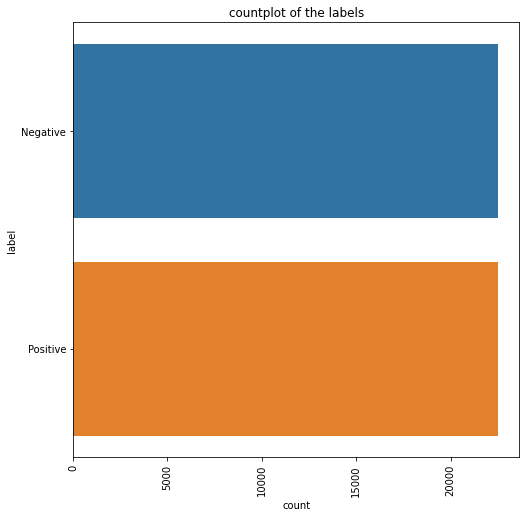

In [15]:
plt.figure(figsize=(8,8))
plt.xticks(rotation=90)
plt.title("countplot of the labels")
sns.countplot(y="label",data=data1)

Here we can see there is almost same number of negative or positive are present

In [16]:
#let's see the distribution of each by using pie chart

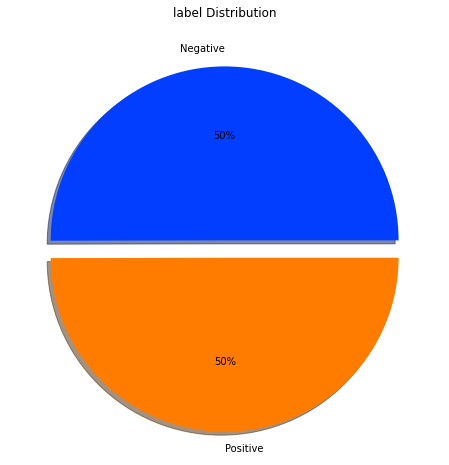

In [17]:
plt.figure(figsize=(8,8))
keys=data1["label"].value_counts().index
values=data1["label"].value_counts().values
plt.title("label Distribution")
# define Seaborn color palette to use
palette_color = sns.color_palette('bright')
plt.pie(values, labels=keys, colors=palette_color, autopct='%.0f%%',shadow=True,explode=(0, 0.1))
plt.show()

AS here we can see the distribution of Positive and Negative commets are same

In [18]:
## Text preprocessing of the text
import re

In [19]:
#import PorterStemmer for the stemming purpose
from nltk.stem import PorterStemmer
ps=PorterStemmer()

In [20]:
#for avoid the stopwords we need to do this 
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [21]:
stops=set(stopwords.words("english"))
print(stops)

{'he', 'them', 'under', 'll', 'i', 'ma', 'that', "haven't", 'needn', 'o', 'weren', 'been', 'through', 'did', 'those', 'mightn', "it's", 'when', 'hadn', 'such', 'for', 'these', 'if', 'isn', 'she', 'my', 'while', 'yourselves', 'haven', 'don', 'won', 'why', 'where', 'they', "hasn't", 'am', 'or', 'how', 'do', 'me', 'are', 'few', 'to', 'too', "needn't", 's', 'because', 'before', 'herself', 'a', 'have', "you're", 'has', "isn't", 'in', 't', 'both', 'then', 'most', "won't", 'out', 'further', 'theirs', 'over', 'its', 'wouldn', "mightn't", 'ourselves', "should've", 'here', 'same', 'than', 'some', 'at', 'ours', 'what', 'from', 'once', "hadn't", 'now', 'all', 'no', 'should', 'being', 'doesn', 'is', 'after', 'this', 'you', 'only', "you'll", 'their', 'm', 'of', 're', 'hers', "aren't", 'nor', "wasn't", 'didn', 'above', 'mustn', 'wasn', "you'd", 'whom', 'aren', 've', 'hasn', 'her', "you've", 'during', 'down', 'can', 'any', 'very', 'couldn', 'him', 'up', "shan't", 'doing', 'as', 'by', 'shan', 'yourself

In [22]:
def preprocessing(x):
  text=re.sub("[^a-zA-Z0-9]"," ",x)
  text=text.lower()
  text=text.split()
  text=[ps.stem(word) for word in text if word not in stops]
  text=" ".join(text)
  return text

In [23]:
preprocessing("Hey! my Name is Gajender and Email is snau)@9592.coms h98@3%8&")

'hey name gajend email snau 9592 com h98 3 8'

In [24]:
data.head(2)

,text,label,dist
0,I grew up (b. 1965) watching and loving the Th...,0,train
1,"When I put this movie in my DVD player, and sa...",0,train


In [25]:
data["text"]=data["text"].apply(preprocessing)
data["text"]

0       grew b 1965 watch love thunderbird mate school...
1       put movi dvd player sat coke chip expect hope ...
2       peopl know particular time past like feel need...
3       even though great interest biblic movi bore de...
4       im die hard dad armi fan noth ever chang got t...
                              ...                        
4995    kind pictur john lassit would make today advan...
4996    must see saw whip press screen hilari talk non...
4997    nbc asham allow children see definit would tel...
4998    movi clumsi mishmash variou ghost stori suspen...
4999    formula movi illegitim son rich chilenian stan...
Name: text, Length: 45000, dtype: object

In [26]:
train_df=data[data["dist"]=="train"]
train_df.shape

(40000, 3)

In [27]:
test_df=data[data["dist"]=="test"]
test_df.shape

(5000, 3)

In [28]:
train_df=train_df.drop("dist",axis=1)

In [29]:
test_df=test_df.drop("dist",axis=1)

In [30]:
train_df.head()

,text,label
0,grew b 1965 watch love thunderbird mate school...,0
1,put movi dvd player sat coke chip expect hope ...,0
2,peopl know particular time past like feel need...,0
3,even though great interest biblic movi bore de...,0
4,im die hard dad armi fan noth ever chang got t...,1


In [31]:
test_df.head()

,text,label
0,alway wrote seri complet stink fest jim belush...,0
1,1st watch 12 7 2002 3 10 dir steve purcel typi...,0
2,movi poorli written direct fell asleep 30 minu...,0
3,interest thing miryang secret sunshin actor je...,1
4,first read berlin meer expect much thought rig...,0


In [32]:
#now create the Wordcloud for the see the word distribution

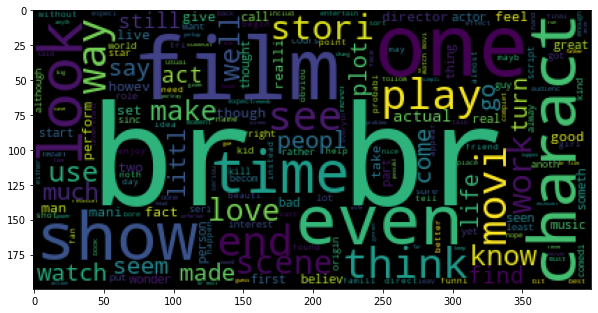

In [33]:
from wordcloud import WordCloud, STOPWORDS
stopwords = set(STOPWORDS)
plt.figure(figsize=(10,10))
row_text=" ".join([word for word in train_df["text"]])
word_cloud=WordCloud().generate(row_text)
plt.imshow(word_cloud)

Now Train the data on the word2vec 

# Important when give data to Word2Vec


1.   text data should be in the list of list format: means word should be saparated by comma and in a list and that sentence should be also in list
2.   example:   [["ram", "shyam", "seeta"],["umesh","ramesh","mahes"]]



In [34]:
text_data=data["text"]
text_data

0       grew b 1965 watch love thunderbird mate school...
1       put movi dvd player sat coke chip expect hope ...
2       peopl know particular time past like feel need...
3       even though great interest biblic movi bore de...
4       im die hard dad armi fan noth ever chang got t...
                              ...                        
4995    kind pictur john lassit would make today advan...
4996    must see saw whip press screen hilari talk non...
4997    nbc asham allow children see definit would tel...
4998    movi clumsi mishmash variou ghost stori suspen...
4999    formula movi illegitim son rich chilenian stan...
Name: text, Length: 45000, dtype: object

In [35]:
for i in data["text"]:
  li=list(i.split(" "))
  print(li)

['grew', 'b', '1965', 'watch', 'love', 'thunderbird', 'mate', 'school', 'watch', 'play', 'thunderbird', 'school', 'lunch', 'school', 'want', 'virgil', 'scott', 'one', 'want', 'alan', 'count', '5', 'becam', 'art', 'form', 'took', 'children', 'see', 'movi', 'hope', 'would', 'get', 'glimps', 'love', 'child', 'bitterli', 'disappoint', 'high', 'point', 'snappi', 'theme', 'tune', 'could', 'compar', 'origin', 'score', 'thunderbird', 'thank', 'earli', 'saturday', 'morn', 'one', 'televis', 'channel', 'still', 'play', 'rerun', 'seri', 'gerri', 'anderson', 'wife', 'creat', 'jonatha', 'frake', 'hand', 'director', 'chair', 'version', 'complet', 'hopeless', 'wast', 'film', 'utter', 'rubbish', 'cgi', 'remak', 'may', 'accept', 'replac', 'marionett', 'homo', 'sapien', 'subsp', 'sapien', 'huge', 'error', 'judgment']
['put', 'movi', 'dvd', 'player', 'sat', 'coke', 'chip', 'expect', 'hope', 'movi', 'would', 'contain', 'strong', 'point', 'first', 'movi', 'awsom', 'anim', 'good', 'flow', 'stori', 'excel', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['hybrid', 'creatur', 'born', 'carl', 'macek', 'mind', 'robotech', 'second', 'gener', 'robotech', 'master', 'megazon', '23', 'one', 'miser', 'movi', 'logic', 'stori', 'bad', 'cannot', 'forgiv', 'action', 'megazon', 'noth', 'robotech', 'movi', 'high', 'rank', 'tv', 'seri', 'said', 'name', 'cannot', 'save']
['2', 'home', 'entertain', 'store', 'seen', 'lot', 'bad', 'movi', 'time', 'one', 'bad', 'compel', 'regist', 'comment', 'bad', 'let', 'say', 'sofia', 'coppola', 'deserv', 'oscar', 'perform', 'godfath', 'iii', 'compar', 'giada', 'colagrand', 'movi', 'br', 'br', 'robot', 'uninspir', 'lover', 'die', 'one', 'month', 'prior', 'arriv', 'rubber', 'hous', 'given', 'discov', 'cheat', 'throughout', 'relationship', 'none', 'seem', 'regist', 'within', 'day', 'start', 'relationship', 'lesli', 'dafo', 'caretak', 'hous', 'even', 'though', 'marri', 'dafo', 'screen', 'scene', 'cold', 'unemot', 'br', 'br', 'plot', 'miss', 'even', 'willem', 'dafo', 'could', 'save', 'movi', 'amateur', 'cinemat', 'train', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['sure', 'start', 'short', 'disappoint', 'movi', 'taught', 'novella', 'awar', 'would', 'hard', 'stori', 'turn', 'movi', 'movi', 'coupl', 'interest', 'line', 'mainli', 'alfr', 'aschenbach', 'repres', 'debat', 'art', 'basic', 'shape', 'novella', 'br', 'br', 'one', 'expect', 'older', 'aschenbach', 'younger', 'tadzio', 'book', 'tadzio', 'fourteen', 'describ', 'pure', 'ideal', 'innoc', 'wherea', 'movi', 'reek', 'sexual', 'teas', 'accomplic', 'aschenbach', 'alway', 'look', 'back', 'almost', 'provokingli', 'book', 'aschenbach', 'steal', 'glanc', 'boy', 'aschenbach', 'imagin', 'someth', 'closer', 'professor', 'turn', 'clown', 'blue', 'angel', 'base', 'stori', 'thoma', 'mann', 'brother', 'heinrich', 'forti', 'year', 'old', 'hardli', 'gray', 'hair', 'fair', 'think', 'dirk', 'bogard', 'good', 'job', 'either', 'someon', 'els', 'done', 'made', 'look', 'older', 'begin', 'br', 'br', 'know', 'discoveri', 'homosexu', 'import', 'stori', 'movi', 'minim', 'talk', 'art', 'dualiti', 'apollonian', 'dyonisian

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['never', 'realiz', 'fabul', 'dancer', 'lana', 'turner', 'saw', 'movi', '19', 'year', 'old', 'gorgeou', 'pleasur', 'watch', 'danc', 'georg', 'murphi', 'stori', 'line', 'typic', 'day', 'danc', 'realli', 'special', 'never', 'tire', 'watch', 'fred', 'ginger', 'lana', 'turner', 'movi', 'terrif', 'alway', 'thought', 'lana', 'actress', 'tend', 'act', 'done', 'danc', 'less', 'maddam', 'x', 'peyton', 'place', 'role', 'new', 'appreci', 'see', 'movi', 'wonder', 'danc', 'bad', 'academi', 'give', 'oscar', 'danc']
['pick', '50', 'cent', 'flea', 'market', 'pretti', 'excit', 'br', 'br', 'found', 'fascin', '15', 'min', 'repetit', 'dull', 'br', 'br', 'neat', 'see', 'mick', 'gang', 'prime', 'wish', 'much', 'dub', 'dialog', 'could', 'hear', 'say', 'play', 'br', 'br', 'skit', 'polit', 'date', 'incred', 'naiv', 'simpl', 'sort', 'poorli', 'written', 'monti', 'python', 'acid', 'spent', 'time', 'look', 'late', '60', 'england', 'back', 'drop', 'rather', 'actual', 'happen', 'silli', 'skit', 'br', 'br', 'movi', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['whole', 'cast', 'crew', 'know', 'f', 'film', 'make', 'br', 'br', 'film', 'concern', 'adventur', 'predica', 'modern', 'day', 'cockney', 'vampir', 'assassin', 'age', 'old', 'spat', 'seemingli', 'jade', 'vampir', 'lover', 'plot', 'reek', 'clich', 'promis', 'boredom', 'small', 'scale', 'film', 'exactli', 'get', 'br', 'br', 'first', 'let', 'say', 'mean', 'dismiss', 'film', 'b', 'movi', 'fact', 'favourit', 'film', 'b', 'movi', 'jesu', 'christ', 'vampir', 'hunter', 'one', 'miss', 'mark', 'mile', 'br', 'br', 'anyon', 'knowledg', 'small', 'budget', 'film', 'know', 'act', 'rare', 'grip', 'emot', 'razor', 'blade', 'smile', 'creat', 'whole', 'new', 'dimens', 'ham', 'screen', 'call', 'act', 'indescrib', 'bad', 'charact', 'spew', 'cheesi', 'one', 'liner', 'fall', 'flat', 'discours', 'express', 'much', 'emot', 'convict', 'termin', 'coupl', 'hors', 'tranquillis', 'br', 'br', 'vast', 'portion', 'film', 'also', 'taken', 'vampir', 'charact', 'protagonist', 'particular', 'unnecessarili', 'flap', 'mouth'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['wherea', 'hard', 'boil', 'detect', 'stori', 'dashiel', 'hammett', 'raymond', 'chandler', 'fit', 'cinema', 'like', 'fox', 'chicken', 'coop', 'inde', 'creat', 'definit', 'modern', 'american', 'genr', 'style', 'process', 'might', 'call', 'golden', 'age', 'fiction', 'made', 'bare', 'impress', 'whatsoev', 'problem', 'book', 'like', 'agatha', 'christi', 'dorothi', 'l', 'sayer', 'van', 'dine', 'whose', 'work', 'film', 'base', 'low', 'action', 'varieti', 'wherea', 'sam', 'spade', 'philip', 'marlow', 'travers', 'mean', 'street', 'la', 'work', 'class', 'tenement', 'bar', 'offic', 'wealthi', 'mansion', 'meet', 'sort', 'excit', 'danger', 'violenc', 'golden', 'age', 'fiction', 'gener', 'fix', 'locat', 'scene', 'murder', 'usual', 'lavish', 'countri', 'hous', 'action', 'limit', 'investig', 'clue', 'interview', 'suspect', 'static', 'procedur', 'plot', 'reduc', 'puzzl', 'br', 'br', 'cours', 'much', 'ideolog', 'anyth', 'els', 'golden', 'age', 'stori', 'deal', 'societi', 'hostil', 'chang', 'movement', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [36]:
Bigger_list=[]
for i in data["text"]:
  li = list(i.split(" "))
  Bigger_list.append(li)

In [37]:
Bigger_list

[['grew',
  'b',
  '1965',
  'watch',
  'love',
  'thunderbird',
  'mate',
  'school',
  'watch',
  'play',
  'thunderbird',
  'school',
  'lunch',
  'school',
  'want',
  'virgil',
  'scott',
  'one',
  'want',
  'alan',
  'count',
  '5',
  'becam',
  'art',
  'form',
  'took',
  'children',
  'see',
  'movi',
  'hope',
  'would',
  'get',
  'glimps',
  'love',
  'child',
  'bitterli',
  'disappoint',
  'high',
  'point',
  'snappi',
  'theme',
  'tune',
  'could',
  'compar',
  'origin',
  'score',
  'thunderbird',
  'thank',
  'earli',
  'saturday',
  'morn',
  'one',
  'televis',
  'channel',
  'still',
  'play',
  'rerun',
  'seri',
  'gerri',
  'anderson',
  'wife',
  'creat',
  'jonatha',
  'frake',
  'hand',
  'director',
  'chair',
  'version',
  'complet',
  'hopeless',
  'wast',
  'film',
  'utter',
  'rubbish',
  'cgi',
  'remak',
  'may',
  'accept',
  'replac',
  'marionett',
  'homo',
  'sapien',
  'subsp',
  'sapien',
  'huge',
  'error',
  'judgment'],
 ['put',
  'movi

In [38]:
#import Word2Vec using gensim
from gensim.models import Word2Vec

In [39]:
w2v_model = Word2Vec(Bigger_list, size=100, window=5, min_count=1)

In [40]:
w2v_model

In [41]:
vocab = list(w2v_model.wv.vocab)

In [42]:
vocab

['grew',
 'b',
 '1965',
 'watch',
 'love',
 'thunderbird',
 'mate',
 'school',
 'play',
 'lunch',
 'want',
 'virgil',
 'scott',
 'one',
 'alan',
 'count',
 '5',
 'becam',
 'art',
 'form',
 'took',
 'children',
 'see',
 'movi',
 'hope',
 'would',
 'get',
 'glimps',
 'child',
 'bitterli',
 'disappoint',
 'high',
 'point',
 'snappi',
 'theme',
 'tune',
 'could',
 'compar',
 'origin',
 'score',
 'thank',
 'earli',
 'saturday',
 'morn',
 'televis',
 'channel',
 'still',
 'rerun',
 'seri',
 'gerri',
 'anderson',
 'wife',
 'creat',
 'jonatha',
 'frake',
 'hand',
 'director',
 'chair',
 'version',
 'complet',
 'hopeless',
 'wast',
 'film',
 'utter',
 'rubbish',
 'cgi',
 'remak',
 'may',
 'accept',
 'replac',
 'marionett',
 'homo',
 'sapien',
 'subsp',
 'huge',
 'error',
 'judgment',
 'put',
 'dvd',
 'player',
 'sat',
 'coke',
 'chip',
 'expect',
 'contain',
 'strong',
 'first',
 'awsom',
 'anim',
 'good',
 'flow',
 'stori',
 'excel',
 'voic',
 'cast',
 'funni',
 'comedi',
 'kick',
 'ass',
 'so

In [43]:
len(vocab)

67627

In [44]:
# w2v_model.wv.most_similar(positive=["some"])

In [45]:
w2v_model.wv.most_similar("plan")

[('decid', 0.6071150302886963),
 ('mission', 0.5934749245643616),
 ('order', 0.5676653981208801),
 ('bank', 0.5673894882202148),
 ('loot', 0.5524623394012451),
 ('arrest', 0.5334281921386719),
 ('sent', 0.5266833305358887),
 ('jail', 0.5266774892807007),
 ('getaway', 0.5183558464050293),
 ('rescu', 0.5169743299484253)]

In [46]:
Bigger_list

[['grew',
  'b',
  '1965',
  'watch',
  'love',
  'thunderbird',
  'mate',
  'school',
  'watch',
  'play',
  'thunderbird',
  'school',
  'lunch',
  'school',
  'want',
  'virgil',
  'scott',
  'one',
  'want',
  'alan',
  'count',
  '5',
  'becam',
  'art',
  'form',
  'took',
  'children',
  'see',
  'movi',
  'hope',
  'would',
  'get',
  'glimps',
  'love',
  'child',
  'bitterli',
  'disappoint',
  'high',
  'point',
  'snappi',
  'theme',
  'tune',
  'could',
  'compar',
  'origin',
  'score',
  'thunderbird',
  'thank',
  'earli',
  'saturday',
  'morn',
  'one',
  'televis',
  'channel',
  'still',
  'play',
  'rerun',
  'seri',
  'gerri',
  'anderson',
  'wife',
  'creat',
  'jonatha',
  'frake',
  'hand',
  'director',
  'chair',
  'version',
  'complet',
  'hopeless',
  'wast',
  'film',
  'utter',
  'rubbish',
  'cgi',
  'remak',
  'may',
  'accept',
  'replac',
  'marionett',
  'homo',
  'sapien',
  'subsp',
  'sapien',
  'huge',
  'error',
  'judgment'],
 ['put',
  'movi

In [47]:
len(Bigger_list)

45000

In [48]:
## this return the vectors of the perticular word 
print(len(w2v_model["back"]))   #size will be what we give when the model training of Word2Vec
w2v_model["back"]


100


<ipython-input-48-e5fdeffc7ab3>:2: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  print(len(w2v_model["back"]))   #size will be what we give when the model training of Word2Vec
<ipython-input-48-e5fdeffc7ab3>:3: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  w2v_model["back"]


array([ 1.1700889 ,  1.1974798 ,  4.3266435 ,  0.7975791 ,  0.3743327 ,
       -2.2647347 ,  0.31170398,  1.5207238 , -2.9933932 ,  1.6972328 ,
        3.7900124 ,  2.0631173 , -1.216082  , -0.20483366,  3.8033702 ,
       -1.3436905 ,  1.8406248 , -1.7487113 ,  2.005434  ,  2.0424755 ,
       -0.22165643, -0.10716899, -0.8534539 ,  1.3711109 , -0.35001817,
        1.2435961 ,  0.8043933 , -0.04955469,  0.3167584 , -0.8052184 ,
        0.73217714,  0.7660399 , -0.5690148 , -0.6553095 , -0.6430112 ,
        2.1510074 ,  1.3504342 ,  0.80471134,  0.7990849 ,  0.9399144 ,
       -0.8833193 , -1.1002601 , -1.2611245 , -1.567553  , -2.0244431 ,
       -1.2173241 , -1.0877978 ,  0.83395725, -0.4049568 ,  0.7289882 ,
        1.102529  , -0.8966951 , -1.0964962 ,  0.5633409 ,  0.7250447 ,
       -0.58367485,  0.79534936, -1.0880138 ,  0.62828904, -1.2671715 ,
       -2.9278815 , -0.49635524,  2.0817711 ,  1.3176231 , -0.47336003,
        0.48387054,  0.5366116 ,  0.14610389, -0.39772293,  1.53

In [55]:
[w2v_model.wv["comedi"]]

[array([-2.2171469 , -0.09030207,  1.0005932 ,  1.9404461 , -1.0881342 ,
         0.65634584, -1.037453  ,  1.419432  , -2.3535662 , -0.49749833,
        -0.15627353,  0.1376867 , -0.5019073 ,  0.78342533,  0.7306795 ,
        -1.6017786 ,  0.05310686, -2.1901739 , -1.5180422 , -0.9759362 ,
         1.1316392 ,  1.3584944 ,  2.5430667 , -0.84627783,  1.6419568 ,
         1.5671005 ,  0.7882713 ,  0.7378196 , -0.39873323,  1.606634  ,
         1.6588682 , -0.40690172,  1.6072272 , -0.27785125, -0.9737849 ,
        -0.36235464,  0.54865944,  0.8150612 ,  1.1144525 ,  2.2630966 ,
         0.9366999 ,  1.3694997 , -2.1002247 ,  1.8867052 , -2.8534927 ,
        -1.2715771 ,  2.5601945 , -0.9311244 ,  1.1631753 , -0.6647204 ,
         1.6619302 ,  2.1683898 , -0.2867157 ,  0.9825659 , -0.9248404 ,
         0.87858105,  0.10977887, -2.4100475 , -0.7001666 , -1.3683913 ,
        -0.75888366,  4.09332   , -3.244905  , -1.1137232 ,  2.2656126 ,
         2.1242394 ,  1.3138784 , -1.3045226 ,  0.5

In [56]:
# w2v_model.wv.vocab

In [60]:
def avg_word2vec(doc):
    # remove out-of-vocabulary words
    #sent = [word for word in doc if word in model.wv.index_to_key]
    #print(sent)
    
    return np.mean([w2v_model.wv[word] for word in doc if word in vocab],axis=0)
                #or [np.zeros(len(model.wv.index_to_key))], axis=0)
        

In [67]:
w2v_model["less"]

<ipython-input-67-6141b0304ef3>:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  w2v_model["less"]


array([ 0.804476  , -1.2090642 , -0.48302925,  1.7195743 ,  0.72428364,
       -0.54274255, -1.7874007 , -0.44189197, -2.2521155 , -0.6170621 ,
       -0.9182098 , -0.7999218 ,  0.07377618, -1.2459064 , -0.23071769,
       -0.17753066,  1.231118  ,  1.2719662 , -0.92135376,  0.5333455 ,
        2.9973993 ,  0.57552093, -0.6338026 , -0.13993299, -1.5763149 ,
       -0.01385131, -0.38457298,  0.19090213, -1.7327744 ,  1.1734842 ,
        0.5479826 ,  0.7475335 ,  1.754632  , -1.2023365 ,  0.33866012,
        0.3419759 , -0.12296487,  0.35308984,  0.63774544,  1.1233315 ,
       -0.16169292, -0.2561436 , -0.0044324 , -1.6504235 ,  0.8141083 ,
        0.12466356, -1.0108496 ,  0.6169636 , -1.6688707 ,  0.3828839 ,
        0.6016099 ,  1.5013272 , -1.2494836 ,  0.00655471,  0.24903312,
        0.615676  , -0.48493657,  0.6773529 , -0.26661873,  0.33381274,
       -0.77012396,  0.49138907, -1.9529808 ,  0.19233982, -0.9392821 ,
       -0.26543894,  0.83891726, -1.523782  ,  0.9840948 , -0.54

In [68]:
len(w2v_model["less"])

<ipython-input-68-7ab76f7cc34b>:1: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  len(w2v_model["less"])


100

In [130]:
def avg(doc):
  m=np.mean([ w2v_model.wv[i] for i in doc if i in vocab],axis=0)
  return m

In [133]:
w=avg(["less","space","word"])
w1=avg([ 'part',
  'cast',
  'produc',
  'humor',
  'film',
  'fall',
  'flat',
  'face',
  'fall',
  'flat',])
w1
print(len(w1))

100


In [116]:
from tqdm.notebook import tqdm, trange

In [135]:
print(len(Bigger_list))

45000


In [138]:
x=[]
for i in Bigger_list:
  x.append(avg_word2vec(i))

In [139]:
x[1]

array([-0.04009086,  0.37773758,  0.7489193 ,  0.03334161, -0.46169665,
       -0.26730204, -0.17502525, -0.09945045, -0.7855047 ,  0.03733246,
        0.35229498, -0.07409326,  0.03411749, -0.43224242, -0.06027409,
        0.0316316 , -0.4599807 , -0.32036412,  0.03379544,  0.3089362 ,
        0.6001368 , -0.47909883, -0.03599706,  0.09319673, -0.05587596,
        0.6372346 , -0.0107947 , -0.01274842,  0.14422506,  0.19871557,
        1.0325475 , -0.14646779,  0.30491093, -0.15443774, -0.430193  ,
        0.37906918,  0.31572068,  0.15607828, -0.4058832 ,  0.83646333,
        0.03937086, -0.04497169, -0.6255218 ,  0.36277658, -0.3951527 ,
        0.00815716,  0.9276364 ,  0.02345468, -0.08752154,  0.19986229,
        0.3963761 ,  0.58148265, -0.7940449 ,  0.0092097 , -1.0639164 ,
        0.47327298, -0.08520256, -0.5342136 ,  0.2348492 , -0.11765479,
       -0.5987018 ,  0.51839197, -0.5576067 ,  0.02526139, -0.7345296 ,
       -0.21826927,  0.2427853 , -0.6715447 ,  0.6371235 ,  0.31

In [140]:
len(x)

45000

In [142]:
x=np.array(x)

In [143]:
y=data["label"]
len(y)

45000

Now Split the data into the training and testing dataset

In [144]:
from sklearn.model_selection import train_test_split

In [146]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.33, random_state=42)

In [147]:
x_train

array([[ 0.16379356,  0.22414531,  0.23034339, ...,  0.39019638,
        -0.15733384,  0.13854384],
       [ 0.24499573,  0.18078771,  0.4703531 , ...,  0.7344599 ,
        -0.5452808 ,  0.4168664 ],
       [ 0.03427117,  0.10227681,  0.39487466, ...,  0.37805742,
        -0.3868426 ,  0.04431842],
       ...,
       [-0.03270903,  0.31143618,  0.38687906, ...,  0.354091  ,
        -0.16828026,  0.47358164],
       [ 0.11194699,  0.45542955,  0.5272976 , ...,  0.34223473,
        -0.13433227,  0.16174114],
       [ 0.21855028,  0.33206573,  0.77154773, ...,  0.5310907 ,
        -0.5614728 ,  0.58819926]], dtype=float32)

Now Train the model using any Classifier model

In [148]:
from sklearn.naive_bayes import GaussianNB

In [149]:
model=GaussianNB()


In [150]:
model.fit(x_train,y_train)

GaussianNB()

In [151]:
y_pred=model.predict(x_test)

In [152]:
model.score(x_train,y_train)

0.7711774461028192

In [153]:
model.score(x_test,y_test)

0.7721212121212121

In [157]:
from sklearn.metrics import classification_report

In [158]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.77      0.76      0.77      7374
           1       0.77      0.78      0.78      7476

    accuracy                           0.77     14850
   macro avg       0.77      0.77      0.77     14850
weighted avg       0.77      0.77      0.77     14850

